In [7]:
%matplotlib inline
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers

from data import load_captions_data, train_val_split
from processing import decode_and_resize

seed = 111
np.random.seed(seed)
tf.random.set_seed(seed)

In [8]:
IMAGES_PATH = "data/Flicker8k_Dataset"
IMAGE_SIZE = (299, 299)
SEQ_LENGTH = 25
captions_mapping, text_data = load_captions_data(IMAGES_PATH, "data/Flickr8k.token.txt", SEQ_LENGTH)

In [9]:
def view_augmentation(transformation, n = 10):
    img = decode_and_resize(np.random.choice(list(captions_mapping.keys())), IMAGE_SIZE)
    fig, axs = plt.subplots(1, n + 1, figsize = (40, 20))
    for idx, ax in enumerate(axs.reshape(-1)):
        if idx == 0:
            ax.imshow(img.numpy().clip(0, 255).astype(np.uint8))
        else:
            ax.imshow(transformation(img).numpy().clip(0, 255).astype(np.uint8))
    plt.show()

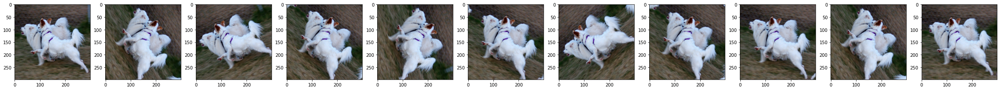

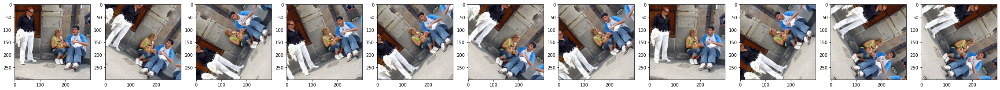

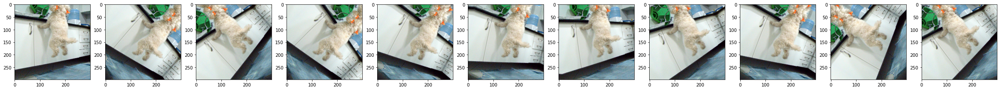

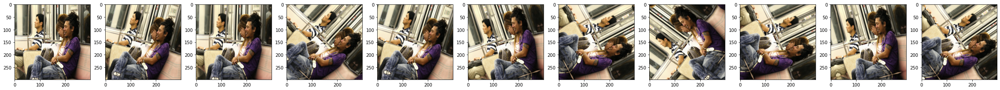

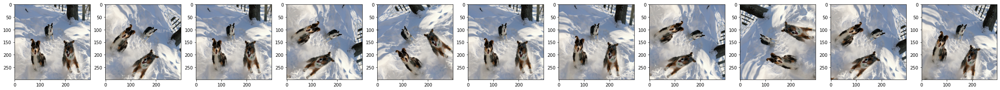

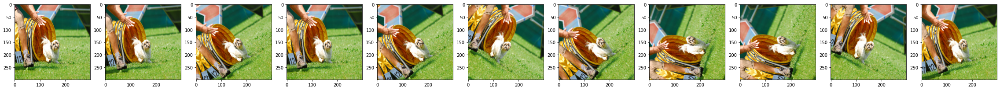

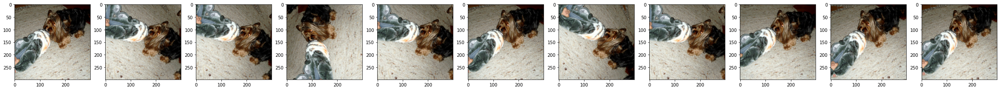

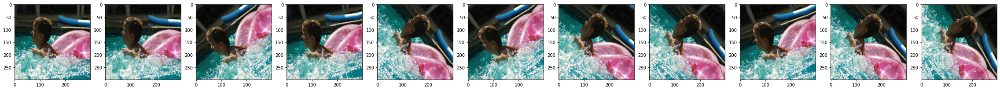

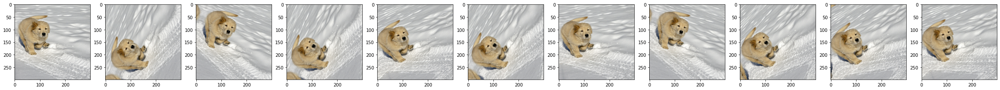

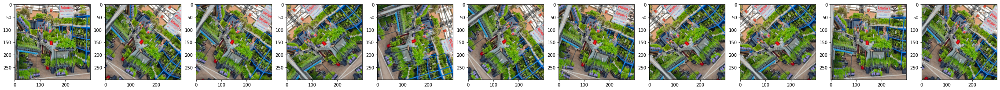

In [10]:
for _ in range(10):
    view_augmentation(layers.RandomRotation((-0.2, 0.2)))

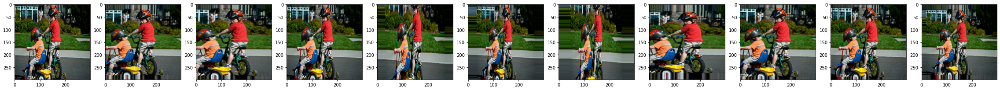

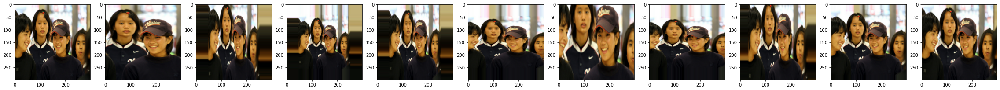

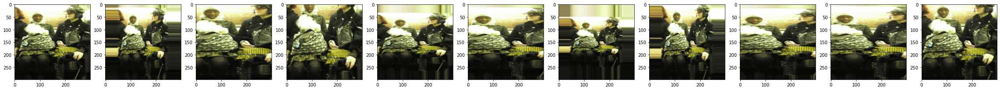

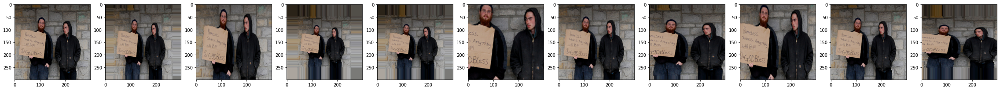

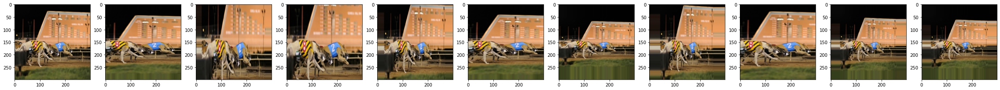

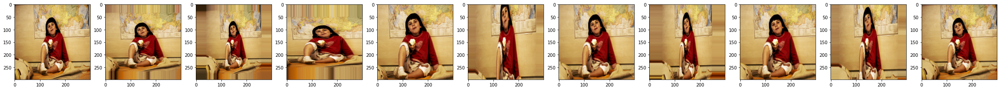

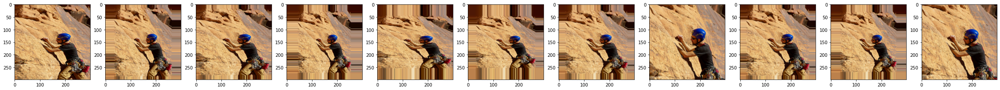

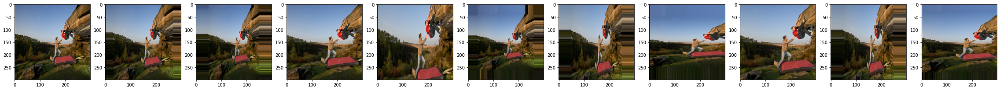

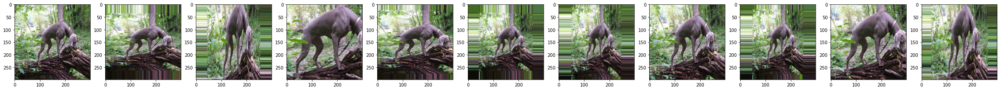

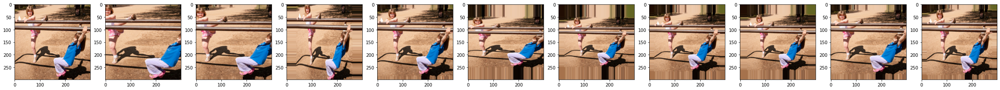

In [11]:
for _ in range(10):
    view_augmentation(layers.RandomZoom(0.5, 0.5, fill_mode='nearest'))

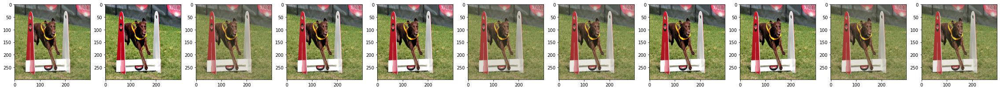

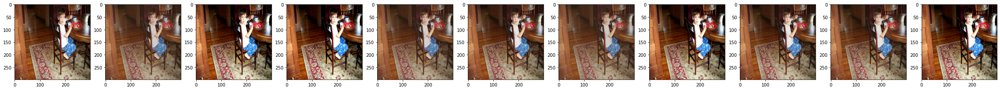

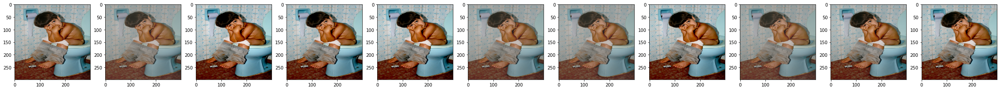

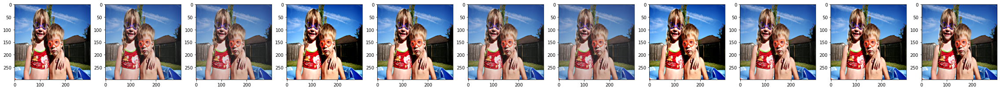

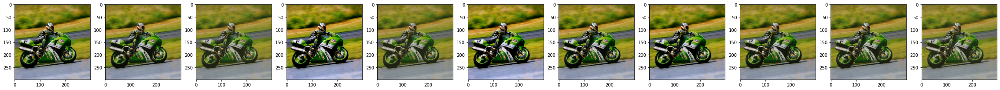

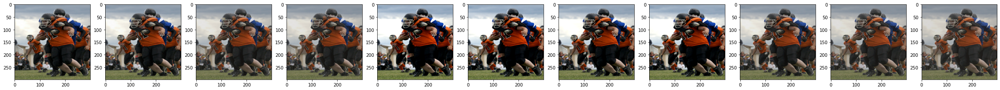

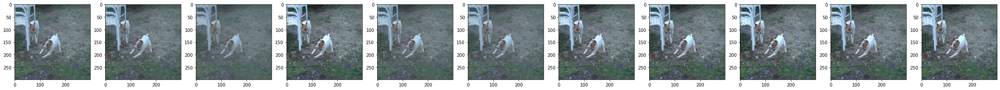

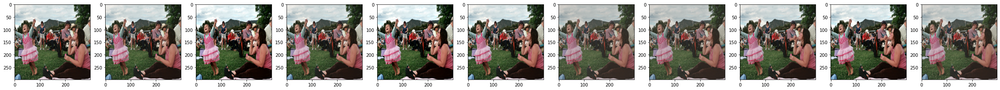

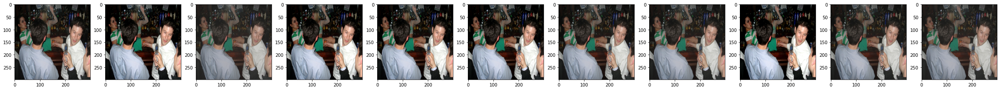

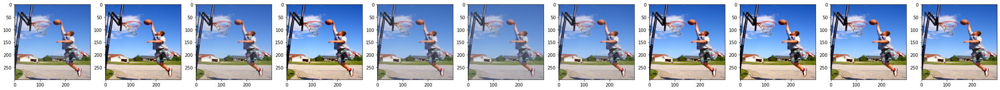

In [12]:
for _ in range(10):
    view_augmentation(layers.RandomContrast((0.3, 0.3)))